<a href="https://colab.research.google.com/github/itz-rakshitha5/Multimodal-Medical-Image-Fusion/blob/main/Capstone_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle

DATASET: https://www.kaggle.com/datasets/noamaanabdulazeem/havard-medical-image-fusion-datasets?resource=download


In [ ]:
from google.colab import files
files.upload()   # upload kaggle.json


Saving CT-MRI.zip to CT-MRI.zip


{'CT-MRI.zip': b'PK\x03\x04\x14\x00\x00\x00\x00\x00\xb8XC\\\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x07\x00 \x00CT-MRI/ux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x075\x89\x81iq\x89\x81i4\x89\x81iPK\x03\x04\x14\x00\x00\x00\x00\x00\xb8XC\\\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\n\x00 \x00CT-MRI/CT/ux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x075\x89\x81iq\x89\x81i4\x89\x81iPK\x03\x04\x14\x00\x08\x00\x08\x00\x98XC\\\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x13\x00 \x00CT-MRI/CT/16003.pngux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x07\xf9\x88\x81iF\x89\x81i4\x89\x81i\xadZ\xe5[\xd3\x8f\xdb\xfdl\x8cQ\x03F\x83\xd4D@\xba;\x07\x02\x02\x12#\xa5\x19)\x12\x82\x94\xa4\x8cN\x91\xee\x16\x90\xee\x92\x1c-\x82\x94\xd2R\x8a\x80\x84\x80t?\xdf\xdf\xff\xf0\xbc\xb8\xeb\xdd}\x9d\xf3\xe6\x9c\xeb:\xd1(\xad\xa7\xc4\x84\x0f\x08\x01\x00 VSU\xd2\x05\x00\x10\xf0\xbf\xc2\xff\xaf\x03\xbet\xe7\xed\xff\r<O5Me\xbc\rB\x1a\\Nq\x19\xed\x80N\x0

In [ ]:
import os
os.listdir("/content")


['.config', 'CT-MRI.zip', 'sample_data']

In [ ]:
!unzip CT-MRI.zip


Archive:  CT-MRI.zip
   creating: CT-MRI/
   creating: CT-MRI/CT/
  inflating: CT-MRI/CT/16003.png     
  inflating: CT-MRI/CT/16004.png     
  inflating: CT-MRI/CT/16005.png     
  inflating: CT-MRI/CT/16006.png     
  inflating: CT-MRI/CT/16007.png     
  inflating: CT-MRI/CT/16008.png     
  inflating: CT-MRI/CT/16009.png     
  inflating: CT-MRI/CT/16010.png     
  inflating: CT-MRI/CT/16011.png     
  inflating: CT-MRI/CT/16012.png     
  inflating: CT-MRI/CT/16013.png     
  inflating: CT-MRI/CT/16014.png     
  inflating: CT-MRI/CT/16015.png     
  inflating: CT-MRI/CT/16016.png     
  inflating: CT-MRI/CT/16017.png     
  inflating: CT-MRI/CT/16018.png     
  inflating: CT-MRI/CT/16019.png     
  inflating: CT-MRI/CT/16020.png     
  inflating: CT-MRI/CT/20005.png     
  inflating: CT-MRI/CT/20006.png     
  inflating: CT-MRI/CT/20007.png     
  inflating: CT-MRI/CT/20008.png     
  inflating: CT-MRI/CT/20009.png     
  inflating: CT-MRI/CT/20010.png     
  inflating: CT-MRI/CT

In [ ]:
import os
os.listdir("/content")


['.config', 'CT-MRI.zip', 'CT-MRI', 'sample_data']

In [ ]:


os.listdir("/content/CT-MRI")


['CT', 'MRI']

In [ ]:
os.listdir("/content/CT-MRI/CT")[:5]
import os
import cv2
import matplotlib.pyplot as plt

ct_dir = "/content/CT-MRI/CT"
mri_dir = "/content/CT-MRI/MRI"



In [ ]:
ct_images = sorted(os.listdir(ct_dir))
mri_images = sorted(os.listdir(mri_dir))

num_ct = len(ct_images)
num_mri = len(mri_images)
total_images = num_ct + num_mri

print("Number of CT images :", num_ct)
print("Number of MRI images:", num_mri)
print("Total images        :", total_images)


Number of CT images : 184
Number of MRI images: 184
Total images        : 368


In [ ]:
# Read one sample image from each category
ct_sample = cv2.imread(os.path.join(ct_dir, ct_images[0]), cv2.IMREAD_GRAYSCALE)
mri_sample = cv2.imread(os.path.join(mri_dir, mri_images[0]), cv2.IMREAD_GRAYSCALE)

print("CT image size  :", ct_sample.shape)
print("MRI image size :", mri_sample.shape)


CT image size  : (256, 256)
MRI image size : (256, 256)


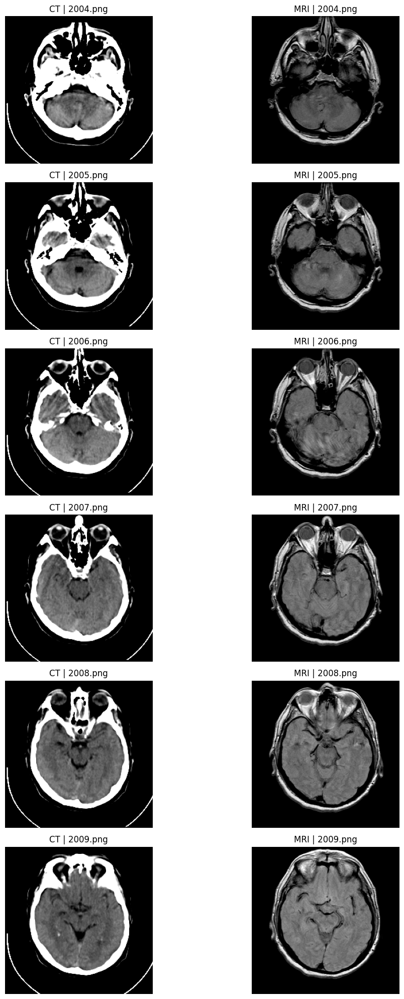

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Paths to dataset
ct_dir = "/content/CT-MRI/CT"
mri_dir = "/content/CT-MRI/MRI"

# List all images and sort them
ct_images = sorted(os.listdir(ct_dir))
mri_images = sorted(os.listdir(mri_dir))

# Filter images starting from 2004.png
start_filename = "2004.png"

ct_start_index = ct_images.index(start_filename)
mri_start_index = mri_images.index(start_filename)

# Select 6 consecutive images from each, ensuring matched filenames
num_samples = 6
ct_selected = ct_images[ct_start_index:ct_start_index + num_samples]
mri_selected = mri_images[mri_start_index:mri_start_index + num_samples]

# Display 6 paired images
plt.figure(figsize=(12, 20))

for i in range(num_samples):
    ct_name = ct_selected[i]
    mri_name = mri_selected[i]

    ct_img = cv2.imread(os.path.join(ct_dir, ct_name), cv2.IMREAD_GRAYSCALE)
    mri_img = cv2.imread(os.path.join(mri_dir, mri_name), cv2.IMREAD_GRAYSCALE)

    # Resize to same dimensions for consistent display
    ct_img = cv2.resize(ct_img, (256, 256))
    mri_img = cv2.resize(mri_img, (256, 256))

    # CT Image
    plt.subplot(num_samples, 2, 2*i + 1)
    plt.imshow(ct_img, cmap='gray')
    plt.title(f"CT | {ct_name}")
    plt.axis("off")

    # MRI Image
    plt.subplot(num_samples, 2, 2*i + 2)
    plt.imshow(mri_img, cmap='gray')
    plt.title(f"MRI | {mri_name}")
    plt.axis("off")

plt.tight_layout()
plt.show()


Total CT images preprocessed: 184
Total MRI images preprocessed: 184


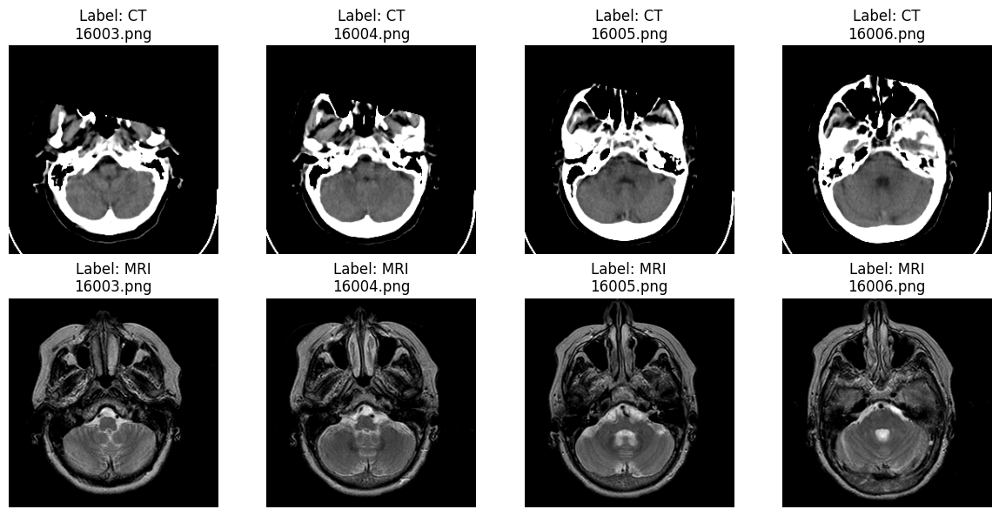

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# ------------------------------
# Dataset Paths
# ------------------------------
ct_dir = "/content/CT-MRI/CT"
mri_dir = "/content/CT-MRI/MRI"

ct_images = sorted(os.listdir(ct_dir))
mri_images = sorted(os.listdir(mri_dir))

# ------------------------------
# Load Image Function
# ------------------------------
def load_image(img_path, normalize=True):
    """
    Load grayscale image and normalize if required.
    """
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)  # already 256x256
    img = img.astype(np.float32)
    if normalize:
        img = img / 255.0
    return img

# ------------------------------
# Preprocess Entire Dataset
# ------------------------------
def preprocess_images(image_list, folder_path):
    preprocessed_imgs = []
    for img_name in image_list:
        img = load_image(os.path.join(folder_path, img_name))
        preprocessed_imgs.append((img_name, img))
    return preprocessed_imgs

ct_preprocessed = preprocess_images(ct_images, ct_dir)
mri_preprocessed = preprocess_images(mri_images, mri_dir)

print(f"Total CT images preprocessed: {len(ct_preprocessed)}")
print(f"Total MRI images preprocessed: {len(mri_preprocessed)}")

# ------------------------------
# Display Sample Images with Labels
# ------------------------------
num_display = 4  # Display first 4 images of each type
plt.figure(figsize=(12, 6))

# CT Samples
for i in range(min(num_display, len(ct_preprocessed))):
    img_name, img = ct_preprocessed[i]
    plt.subplot(2, num_display, i+1)
    plt.imshow(img, cmap='gray')
    plt.title(f"Label: CT\n{img_name}")
    plt.axis('off')

# MRI Samples
for i in range(min(num_display, len(mri_preprocessed))):
    img_name, img = mri_preprocessed[i]
    plt.subplot(2, num_display, num_display+i+1)
    plt.imshow(img, cmap='gray')
    plt.title(f"Label: MRI\n{img_name}")
    plt.axis('off')

plt.tight_layout()
plt.show()


Using device: cuda


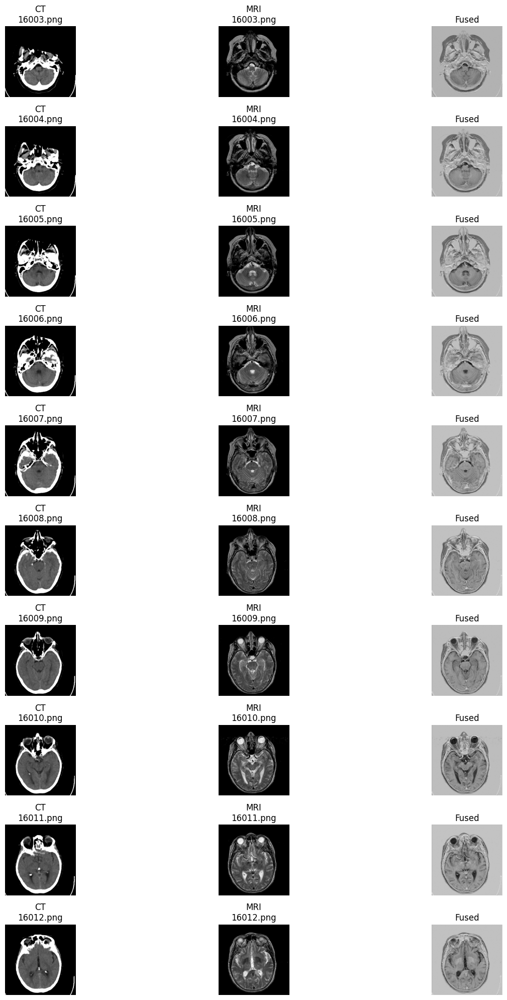

Execution Time: 2.29 seconds


In [ ]:
import os
import time
import torch# pytorch's main library
import torch.nn as nn
import matplotlib.pyplot as plt
from PIL import Image # work with images
import numpy as np

# --------------------------
# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# --------------------------
# Load images
def load_image(path):
    img = Image.open(path).convert("L")  # grayscale
    img = np.array(img).astype(np.float32) / 255.0  # normalize 0-1
    return img

# --------------------------
# CNN Branch
class CNNBranch(nn.Module):
    def __init__(self, out_channels=32):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(1, 16, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(16, out_channels, 3, padding=1),
            nn.ReLU()
        )
    def forward(self, x):
        return self.conv(x)

# --------------------------
# Transformer Branch
class TransformerBranch(nn.Module):
    def __init__(self, in_channels=1, embed_dim=64, num_heads=4):
        super().__init__()
        self.proj = nn.Conv2d(in_channels, embed_dim, 1)  # map 1->64
        self.attn = nn.MultiheadAttention(embed_dim=embed_dim, num_heads=num_heads)
    def forward(self, x):
        b, c, h, w = x.shape
        x = self.proj(x)  # (b, embed_dim, h, w)
        x = x.view(b, x.shape[1], h*w).permute(0, 2, 1)  # (b, H*W, embed_dim)
        x, _ = self.attn(x, x, x)
        x = x.permute(0, 2, 1).view(b, -1, h, w)
        return x

# --------------------------
# Fusion Projection (to match channels)
class FusionProject(nn.Module):
    def __init__(self, in_channels_cnn=32, in_channels_trans=64, out_channels=64):
        super().__init__()
        self.cnn_proj = nn.Conv2d(in_channels_cnn, out_channels, 1)
        self.trans_proj = nn.Conv2d(in_channels_trans, out_channels, 1)
    def forward(self, f_cnn, f_trans):
        f_cnn = self.cnn_proj(f_cnn)
        f_trans = self.trans_proj(f_trans)
        return (f_cnn + f_trans) / 2

# --------------------------
# Paths
ct_dir = "/content/CT-MRI/CT"
mri_dir = "/content/CT-MRI/MRI"

ct_images = sorted([f for f in os.listdir(ct_dir) if f.endswith(".png")])
mri_images = sorted([f for f in os.listdir(mri_dir) if f.endswith(".png")])

# --------------------------
# Initialize models
cnn = CNNBranch().to(device)
transformer = TransformerBranch().to(device)
fusion = FusionProject().to(device)

# --------------------------
# Run fusion
start_time = time.time()
plt.figure(figsize=(15, 20))

num_images = min(10, len(ct_images), len(mri_images))

for i in range(num_images):
    ct_path = os.path.join(ct_dir, ct_images[i])
    mri_path = os.path.join(mri_dir, mri_images[i])

    ct = load_image(ct_path)
    mri = load_image(mri_path)

    ct_t = torch.tensor(ct).unsqueeze(0).unsqueeze(0).float().to(device)  # (1,1,H,W)
    mri_t = torch.tensor(mri).unsqueeze(0).unsqueeze(0).float().to(device)

    with torch.no_grad():
        f_ct = cnn(ct_t)
        f_mri = transformer(mri_t)
        fused_feat = fusion(f_ct, f_mri)
        fused = fused_feat.mean(dim=1).squeeze().cpu().numpy()  # collapse channel

    # --------------------------
    # Display
    plt.subplot(num_images, 3, i*3 + 1)
    plt.imshow(ct, cmap='gray')
    plt.title(f"CT\n{ct_images[i]}")
    plt.axis("off")

    plt.subplot(num_images, 3, i*3 + 2)
    plt.imshow(mri, cmap='gray')
    plt.title(f"MRI\n{mri_images[i]}")
    plt.axis("off")

    plt.subplot(num_images, 3, i*3 + 3)
    plt.imshow(fused, cmap='gray')
    plt.title("Fused")
    plt.axis("off")

plt.tight_layout()
plt.show()
end_time = time.time()
print("Execution Time:", round(end_time - start_time, 2), "seconds")


In [ ]:
import torch
import time

def run_training(device, num_epochs=5):
    print(f"\nRunning training on {device}...\n")

    cnn = CNNBranch().to(device)
    transformer = TransformerBranch().to(device)
    optimizer = torch.optim.Adam(list(cnn.parameters()) + list(transformer.parameters()), lr=1e-3)
    criterion = nn.MSELoss()

    start_time = time.time()

    for epoch in range(num_epochs):
        cnn.train()
        transformer.train()
        total_loss = 0
        for ct, mri in train_loader:
            ct = ct.to(device)
            mri = mri.to(device)

            optimizer.zero_grad()
            f_ct = cnn(ct)
            f_mri = transformer(mri)
            fused = cross_attention_fusion(f_ct, f_mri)
            target = (ct + mri) / 2
            loss = criterion(fused, target)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {total_loss/len(train_loader):.4f}")

    end_time = time.time()
    print(f"Total execution time on {device}: {end_time-start_time:.2f} seconds")
    return end_time - start_time

# --------------------------
# Run on CPU
# --------------------------
cpu_time = run_training(torch.device("cpu"), num_epochs=5)

# --------------------------
# Run on GPU (CUDA)
# --------------------------
if torch.cuda.is_available():
    cuda_time = run_training(torch.device("cuda"), num_epochs=5)
else:
    cuda_time = None
    print("CUDA not available")

print("\nSummary:")
print(f"CPU execution time: {cpu_time:.2f} s")
if cuda_time:
    print(f"GPU execution time: {cuda_time:.2f} s")



Running training on cpu...

Epoch [1/5], Loss: 0.0402
Epoch [2/5], Loss: 0.0126
Epoch [3/5], Loss: 0.0078
Epoch [4/5], Loss: 0.0059
Epoch [5/5], Loss: 0.0053
Total execution time on cpu: 294.88 seconds

Running training on cuda...

Epoch [1/5], Loss: 0.0431
Epoch [2/5], Loss: 0.0093
Epoch [3/5], Loss: 0.0049
Epoch [4/5], Loss: 0.0035
Epoch [5/5], Loss: 0.0030
Total execution time on cuda: 12.59 seconds

Summary:
CPU execution time: 294.88 s
GPU execution time: 12.59 s


In [ ]:
# --------------------------
# Step 0: Imports
# --------------------------
import os
import random
import numpy as np
from glob import glob
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.transforms as transforms
from PIL import Image
import time

# --------------------------
# Step 1: Device
# --------------------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# --------------------------
# Step 2: Dataset Class
# --------------------------
class CTMRIDataset(Dataset):
    def __init__(self, ct_dir, mri_dir, transform=None):
        self.ct_images = sorted(glob(os.path.join(ct_dir, "*.png")))
        self.mri_images = sorted(glob(os.path.join(mri_dir, "*.png")))
        assert len(self.ct_images) == len(self.mri_images), "Mismatch CT & MRI image counts"
        self.transform = transform

    def __len__(self):
        return len(self.ct_images)

    def __getitem__(self, idx):
        ct = Image.open(self.ct_images[idx]).convert("L")  # grayscale
        mri = Image.open(self.mri_images[idx]).convert("L")
        if self.transform:
            ct = self.transform(ct)
            mri = self.transform(mri)
        return ct, mri

# --------------------------
# Step 3: Transforms
# --------------------------
transform = transforms.Compose([
    transforms.ToTensor(),  # converts to [0,1] float tensor
])

# --------------------------
# Step 4: Load Dataset & Split
# --------------------------
ct_dir = "/content/CT-MRI/CT"
mri_dir = "/content/CT-MRI/MRI"

dataset = CTMRIDataset(ct_dir, mri_dir, transform=transform)
train_size = int(0.8 * len(dataset)) # 80% training
test_size = len(dataset) - train_size # 20% testing
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

print("Train images:", len(train_dataset))
print("Test images:", len(test_dataset))

# --------------------------
# Step 5: Model Definition
# --------------------------
class CNNBranch(nn.Module):
    def __init__(self, in_channels=1):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, 16, 3, padding=1),
            nn.ReLU(),
            nn.Conv2d(16, 32, 3, padding=1),
            nn.ReLU()
        )
    def forward(self, x):
        return self.conv(x)

class TransformerBranch(nn.Module):
    def __init__(self, in_channels=1, embed_dim=32, num_heads=4):  # smaller embed_dim to save memory
        super().__init__()
        self.proj = nn.Conv2d(in_channels, embed_dim, kernel_size=1)  # map 1->embed_dim
        self.attn = nn.MultiheadAttention(embed_dim=embed_dim, num_heads=num_heads)
    def forward(self, x):
        b, c, h, w = x.shape
        x = self.proj(x)                 # (b, embed_dim, h, w)
        x = x.view(b, x.shape[1], h*w).permute(0, 2, 1)  # (b, H*W, embed_dim)
        x, _ = self.attn(x, x, x)
        x = x.permute(0, 2, 1).view(b, -1, h, w)  # back to (b, embed_dim, h, w)
        return x

def cross_attention_fusion(f1, f2):
    # simple average fusion
    # make sure f1, f2 same channel size
    if f1.shape[1] != f2.shape[1]:
        # adjust f2 channels using 1x1 conv
        conv_adjust = nn.Conv2d(f2.shape[1], f1.shape[1], kernel_size=1).to(f1.device)
        f2 = conv_adjust(f2)
    return (f1 + f2) / 2

# --------------------------
# Step 6: Initialize Model
# --------------------------
cnn = CNNBranch().to(device)
transformer = TransformerBranch().to(device)

# --------------------------
# Step 7: Optimizer & Loss
# --------------------------
optimizer = torch.optim.Adam(list(cnn.parameters()) + list(transformer.parameters()), lr=1e-3)
criterion = nn.MSELoss()  # unsupervised fusion, target can be average CT+MRI

# --------------------------
# Step 8: Training Loop
# --------------------------
num_epochs = 20

for epoch in range(num_epochs):
    cnn.train()
    transformer.train()
    total_loss = 0
    start_time = time.time()
    for ct, mri in train_loader:
        ct = ct.to(device)
        mri = mri.to(device)

        optimizer.zero_grad()
        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri)

        # unsupervised target: simple average of input images
        target = (ct + mri) / 2
        loss = criterion(fused, target)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    end_time = time.time()
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {total_loss/len(train_loader):.4f}, Time: {end_time-start_time:.2f}s")

print("Training completed!")

# --------------------------
# Step 9: Inference Example
# --------------------------
cnn.eval()
transformer.eval()
with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        ct = ct.to(device)
        mri = mri.to(device)
        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()
        if i >= 5:  # show 5 examples
            break


Using device: cuda
Train images: 147
Test images: 37


/usr/local/lib/python3.12/dist-packages/torch/nn/modules/loss.py:634: UserWarning: Using a target size (torch.Size([4, 1, 256, 256])) that is different to the input size (torch.Size([4, 32, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/usr/local/lib/python3.12/dist-packages/torch/nn/modules/loss.py:634: UserWarning: Using a target size (torch.Size([3, 1, 256, 256])) that is different to the input size (torch.Size([3, 32, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/20], Loss: 0.0358, Time: 2.87s
Epoch [2/20], Loss: 0.0079, Time: 2.47s
Epoch [3/20], Loss: 0.0048, Time: 2.50s
Epoch [4/20], Loss: 0.0035, Time: 2.46s
Epoch [5/20], Loss: 0.0030, Time: 2.48s
Epoch [6/20], Loss: 0.0028, Time: 2.49s
Epoch [7/20], Loss: 0.0028, Time: 2.53s
Epoch [8/20], Loss: 0.0027, Time: 2.50s
Epoch [9/20], Loss: 0.0027, Time: 2.47s
Epoch [10/20], Loss: 0.0026, Time: 2.46s
Epoch [11/20], Loss: 0.0026, Time: 2.46s
Epoch [12/20], Loss: 0.0026, Time: 2.51s
Epoch [13/20], Loss: 0.0025, Time: 2.43s
Epoch [14/20], Loss: 0.0025, Time: 2.41s
Epoch [15/20], Loss: 0.0025, Time: 2.41s
Epoch [16/20], Loss: 0.0025, Time: 2.41s
Epoch [17/20], Loss: 0.0024, Time: 2.48s
Epoch [18/20], Loss: 0.0024, Time: 2.39s
Epoch [19/20], Loss: 0.0024, Time: 2.39s
Epoch [20/20], Loss: 0.0024, Time: 2.39s
Training completed!


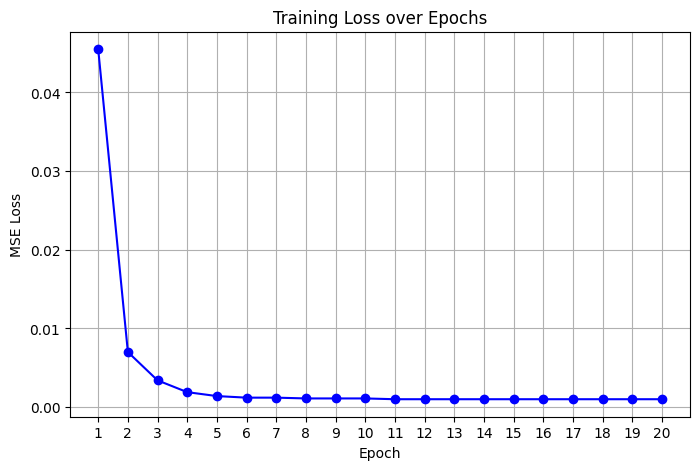

In [ ]:
import matplotlib.pyplot as plt

# Loss values from your training log
loss_history = [
    0.0455, 0.0070, 0.0034, 0.0019, 0.0014, 0.0012, 0.0012, 0.0011, 0.0011, 0.0011,
    0.0010, 0.0010, 0.0010, 0.0010, 0.0010, 0.0010, 0.0010, 0.0010, 0.0010, 0.0010
]

plt.figure(figsize=(8,5))
plt.plot(range(1, len(loss_history)+1), loss_history, marker='o', color='blue')
plt.title("Training Loss over Epochs")
plt.xlabel("Epoch")
plt.ylabel("MSE Loss")
plt.xticks(range(1, len(loss_history)+1))
plt.grid(True)
plt.show()


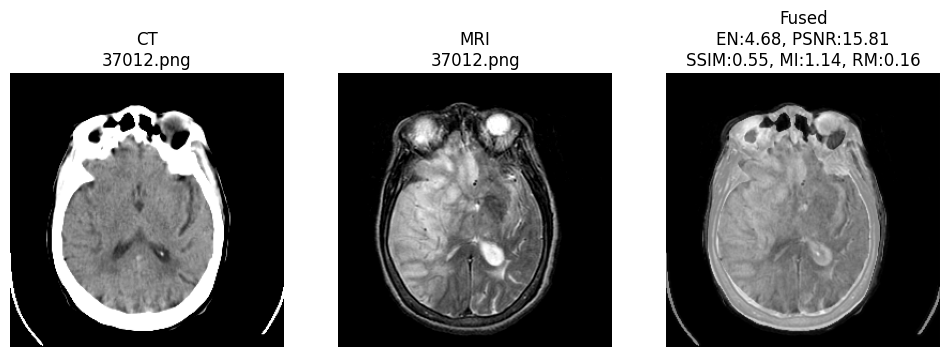

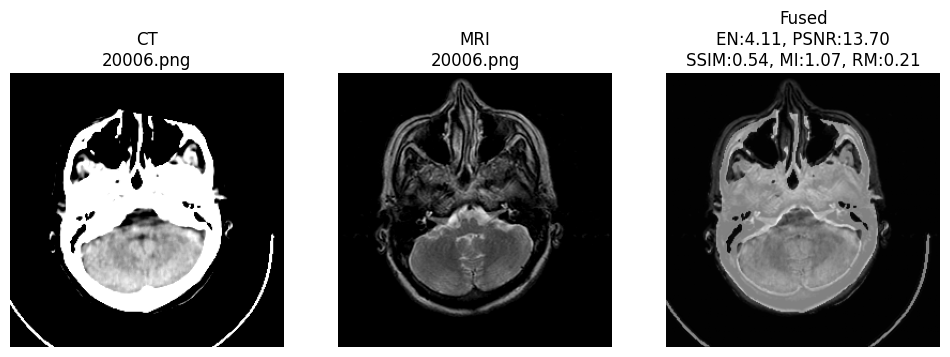

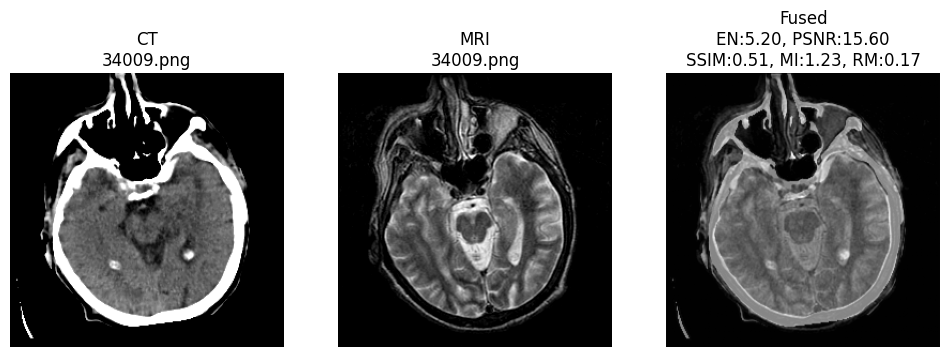

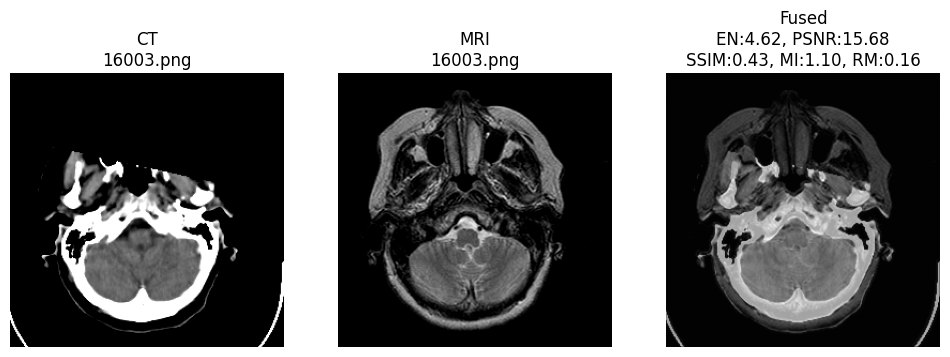

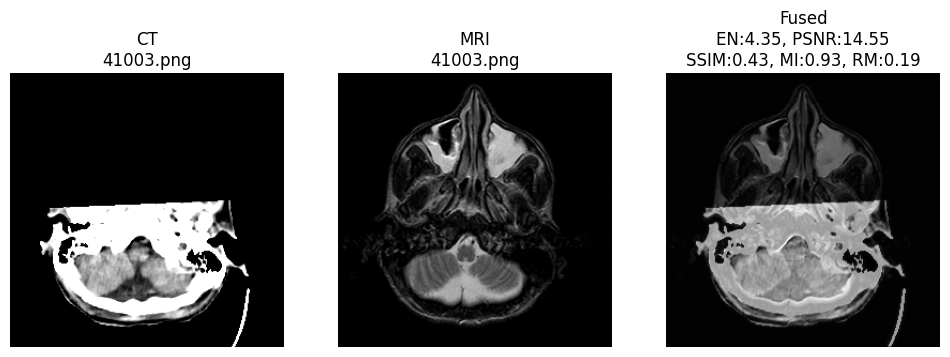


Average Metrics on Test Set:
Entropy: 4.5935
PSNR: 15.0673
SSIM: 0.4916
Mutual Info: 1.0946
RMSE: 0.1773


In [ ]:

import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
from math import log10

# --------------------------
# Metric functions
# --------------------------
def entropy(img):
    hist, _ = np.histogram(img.flatten(), bins=256)
    hist = hist / hist.sum()
    return -np.sum(hist * np.log2(hist + 1e-10))

def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    return 20 * log10(1.0 / np.sqrt(mse))

def rmse(img1, img2):
    return np.sqrt(np.mean((img1 - img2) ** 2))

def mutual_information(x, y):
    hist_2d, _, _ = np.histogram2d(x.flatten(), y.flatten(), bins=64)
    pxy = hist_2d / np.sum(hist_2d)
    px = np.sum(pxy, axis=1)
    py = np.sum(pxy, axis=0)
    px_py = px[:, None] * py[None, :]
    return np.sum(pxy * np.log2((pxy + 1e-10) / (px_py + 1e-10)))

# --------------------------
# Testing
# --------------------------
cnn.eval()
transformer.eval()

fused_images = []
metric_results = []

with torch.no_grad():
    for idx, (ct, mri) in enumerate(test_loader):
        ct = ct.to(device)
        mri = mri.to(device)

        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri)

        # fused image: reduce channel dimension to 1
        fused_img = fused.mean(dim=1).squeeze().cpu().numpy()
        fused_images.append(fused_img)

        # Convert tensors to numpy for metrics
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Compute metrics
        EN = entropy(fused_img)
        PS = psnr(ct_np, fused_img)
        SS = ssim(ct_np, fused_img, data_range=fused_img.max() - fused_img.min())
        MI = mutual_information(ct_np, fused_img)
        RM = rmse(ct_np, fused_img)

        metric_results.append({
            "Entropy": EN,
            "PSNR": PS,
            "SSIM": SS,
            "Mutual Info": MI,
            "RMSE": RM
        })

        # Get actual image filenames from dataset
        ct_filename = dataset.ct_images[test_dataset.indices[idx]]
        mri_filename = dataset.mri_images[test_dataset.indices[idx]]

        # Display fused image alongside inputs with filenames
        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1)
        plt.imshow(ct_np, cmap='gray')
        plt.title(f"CT\n{os.path.basename(ct_filename)}")
        plt.axis("off")

        plt.subplot(1,3,2)
        plt.imshow(mri_np, cmap='gray')
        plt.title(f"MRI\n{os.path.basename(mri_filename)}")
        plt.axis("off")

        plt.subplot(1,3,3)
        plt.imshow(fused_img, cmap='gray')
        plt.title(f"Fused\nEN:{EN:.2f}, PSNR:{PS:.2f}\nSSIM:{SS:.2f}, MI:{MI:.2f}, RM:{RM:.2f}")
        plt.axis("off")
        plt.show()

        if idx >= 4:  # show first 5 test images
            break

# --------------------------
# Print Average Metrics
# --------------------------
avg_metrics = {k: np.mean([m[k] for m in metric_results]) for k in metric_results[0]}
print("\nAverage Metrics on Test Set:")
for k, v in avg_metrics.items():
    print(f"{k}: {v:.4f}")


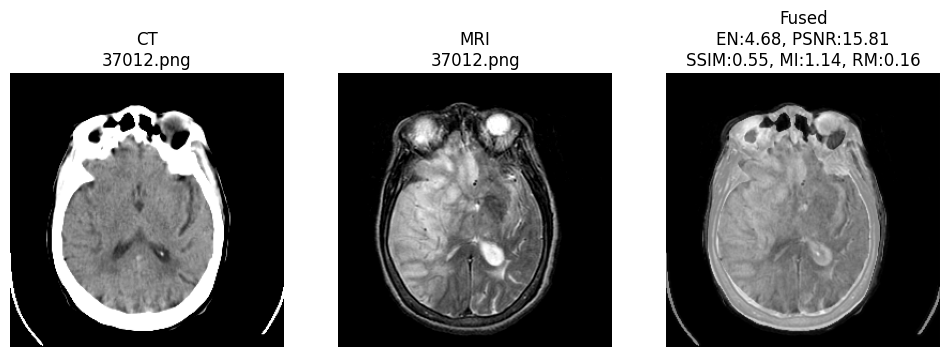

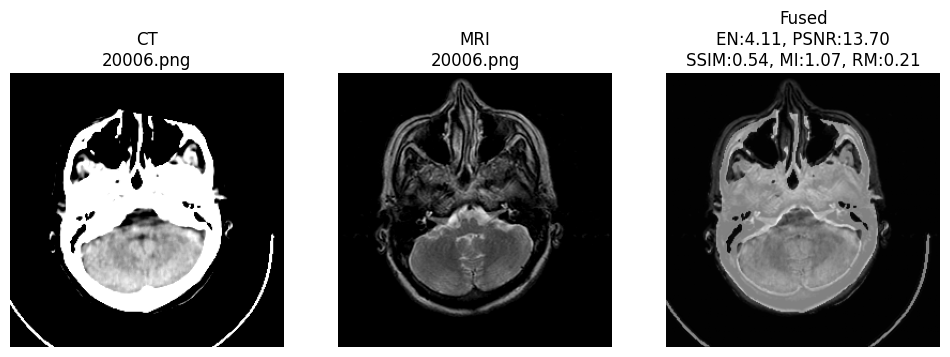

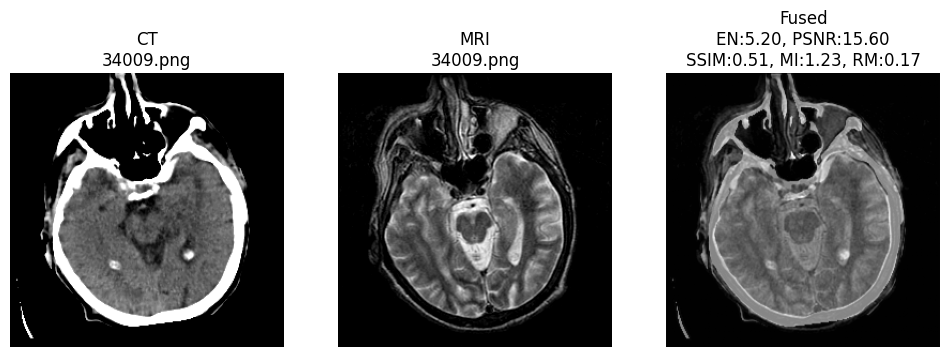

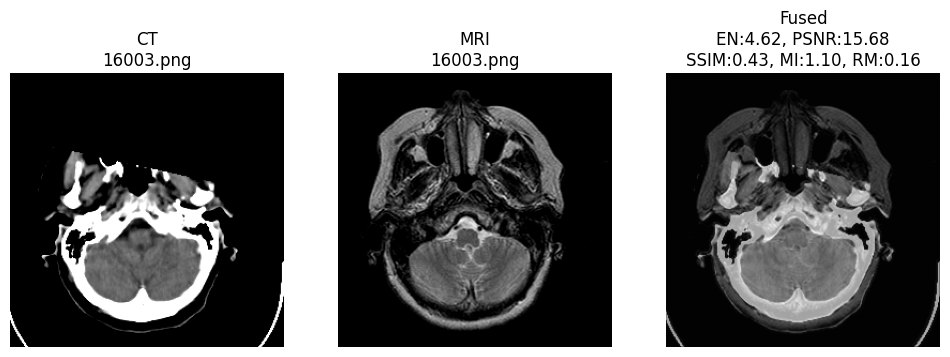

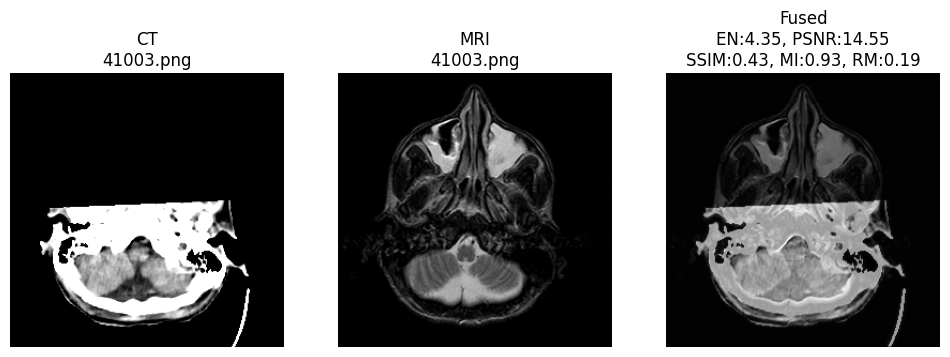

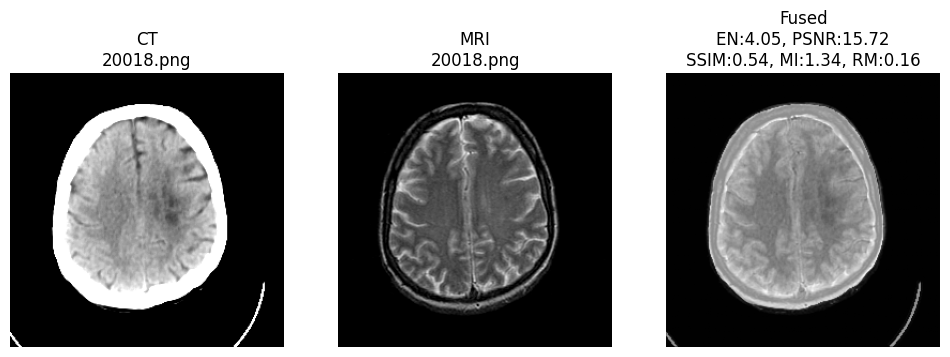

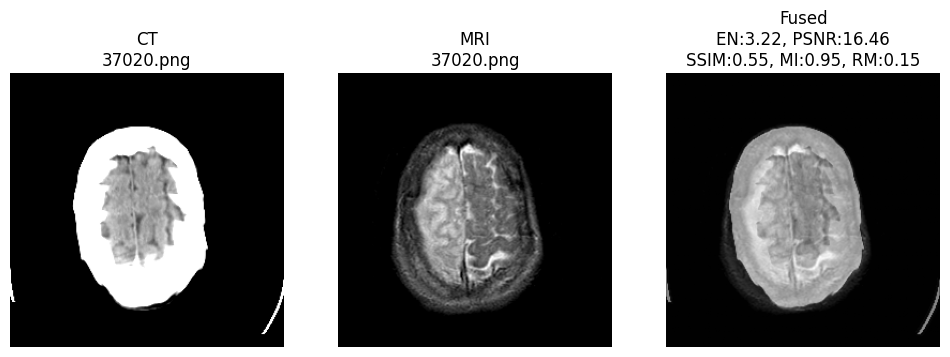

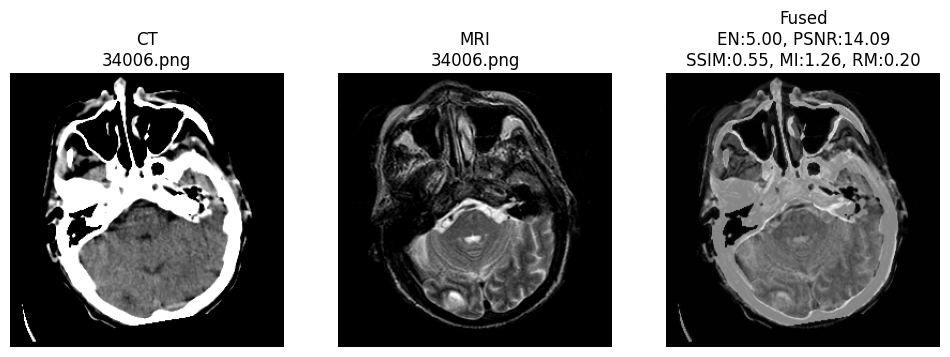

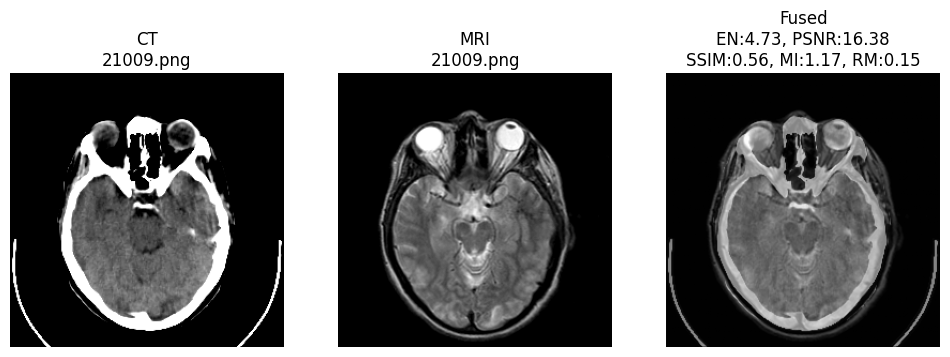

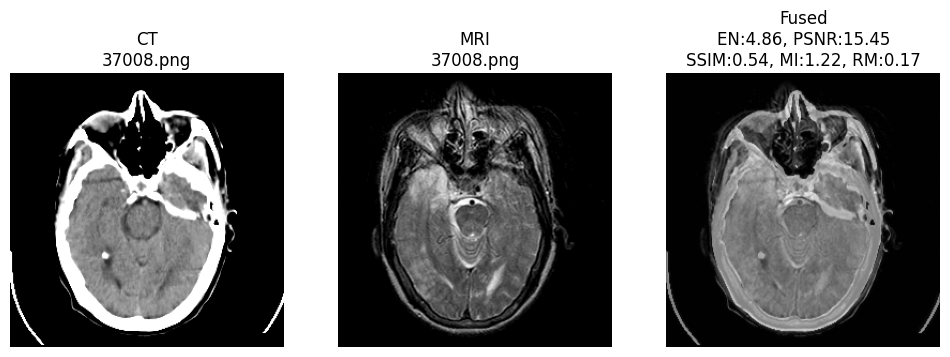


Average Metrics on Test Set (first 10 images):
Entropy: 4.4823
PSNR: 15.3439
SSIM: 0.5191
Mutual Info: 1.1414
RMSE: 0.1718


In [ ]:
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
from math import log10

# --------------------------
# Metric functions
# --------------------------
def entropy(img):
    hist, _ = np.histogram(img.flatten(), bins=256)
    hist = hist / hist.sum()
    return -np.sum(hist * np.log2(hist + 1e-10))

def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    return 20 * log10(1.0 / np.sqrt(mse))

def rmse(img1, img2):
    return np.sqrt(np.mean((img1 - img2) ** 2))

def mutual_information(x, y):
    hist_2d, _, _ = np.histogram2d(x.flatten(), y.flatten(), bins=64)
    pxy = hist_2d / np.sum(hist_2d)
    px = np.sum(pxy, axis=1)
    py = np.sum(pxy, axis=0)
    px_py = px[:, None] * py[None, :]
    return np.sum(pxy * np.log2((pxy + 1e-10) / (px_py + 1e-10)))

# --------------------------
# Testing
# --------------------------
cnn.eval()
transformer.eval()

fused_images = []
metric_results = []

with torch.no_grad():
    for idx, (ct, mri) in enumerate(test_loader):
        ct = ct.to(device)
        mri = mri.to(device)

        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri)

        # fused image: reduce channel dimension to 1
        fused_img = fused.mean(dim=1).squeeze().cpu().numpy()
        fused_images.append(fused_img)

        # Convert tensors to numpy for metrics
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Compute metrics
        EN = entropy(fused_img)
        PS = psnr(ct_np, fused_img)
        SS = ssim(ct_np, fused_img, data_range=fused_img.max() - fused_img.min())
        MI = mutual_information(ct_np, fused_img)
        RM = rmse(ct_np, fused_img)

        metric_results.append({
            "Entropy": EN,
            "PSNR": PS,
            "SSIM": SS,
            "Mutual Info": MI,
            "RMSE": RM
        })

        # Get actual image filenames from dataset
        ct_filename = dataset.ct_images[test_dataset.indices[idx]]
        mri_filename = dataset.mri_images[test_dataset.indices[idx]]

        # Display fused image alongside inputs with filenames
        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1)
        plt.imshow(ct_np, cmap='gray')
        plt.title(f"CT\n{os.path.basename(ct_filename)}")
        plt.axis("off")

        plt.subplot(1,3,2)
        plt.imshow(mri_np, cmap='gray')
        plt.title(f"MRI\n{os.path.basename(mri_filename)}")
        plt.axis("off")

        plt.subplot(1,3,3)
        plt.imshow(fused_img, cmap='gray')
        plt.title(f"Fused\nEN:{EN:.2f}, PSNR:{PS:.2f}\nSSIM:{SS:.2f}, MI:{MI:.2f}, RM:{RM:.2f}")
        plt.axis("off")
        plt.show()

        if idx >= 9:  # show first 10 test images
            break

# --------------------------
# Print Average Metrics
# --------------------------
avg_metrics = {k: np.mean([m[k] for m in metric_results]) for k in metric_results[0]}
print("\nAverage Metrics on Test Set (first 10 images):")
for k, v in avg_metrics.items():
    print(f"{k}: {v:.4f}")


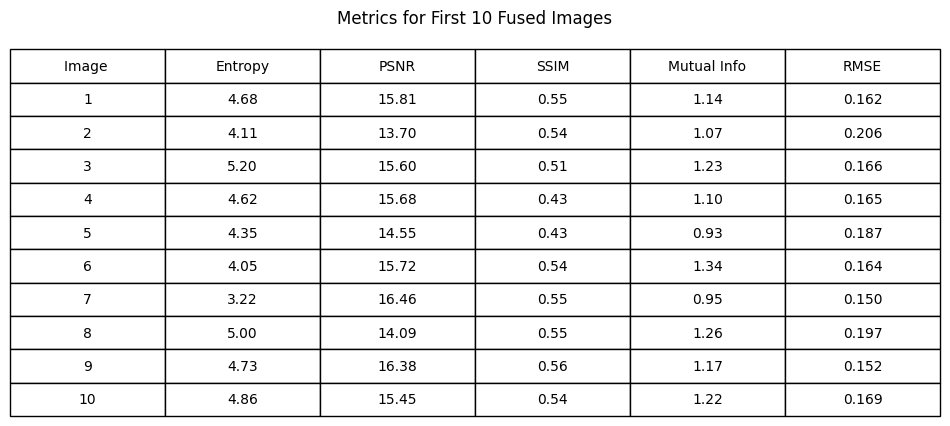

In [ ]:
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
import numpy as np

# Lists to store metrics
image_numbers = []
entropy_vals = []
psnr_vals = []
ssim_vals = []
mi_vals = []
rmse_vals = []

# ---------------- Metrics Functions ----------------
def entropy(img):
    hist, _ = np.histogram(img.flatten(), bins=256)
    hist = hist / hist.sum()
    return -np.sum(hist * np.log2(hist + 1e-10))

def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    return 20 * np.log10(1.0 / np.sqrt(mse))

def rmse(img1, img2):
    return np.sqrt(np.mean((img1 - img2) ** 2))

def mutual_information(x, y):
    hist_2d, _, _ = np.histogram2d(x.flatten(), y.flatten(), bins=64)
    pxy = hist_2d / np.sum(hist_2d)
    px = np.sum(pxy, axis=1)
    py = np.sum(pxy, axis=0)
    px_py = px[:, None] * py[None, :]
    return np.sum(pxy * np.log2((pxy + 1e-10) / (px_py + 1e-10)))

# ---------------- Inference on first 10 test images ----------------
cnn.eval()
transformer.eval()
with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:  # first 10 images only
            break
        ct = ct.to(device)
        mri = mri.to(device)

        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Save metrics
        image_numbers.append(i+1)
        entropy_vals.append(entropy(fused))
        psnr_vals.append(psnr(ct_np, fused))
        ssim_vals.append(ssim(ct_np, fused, data_range=fused.max()-fused.min()))
        mi_vals.append(mutual_information(ct_np, fused))
        rmse_vals.append(rmse(ct_np, fused))

# ---------------- Create Table ----------------
fig, ax = plt.subplots(figsize=(12,4))
ax.axis('tight')
ax.axis('off')

table_data = []
for i in range(len(image_numbers)):
    table_data.append([
        image_numbers[i],
        f"{entropy_vals[i]:.2f}",
        f"{psnr_vals[i]:.2f}",
        f"{ssim_vals[i]:.2f}",
        f"{mi_vals[i]:.2f}",
        f"{rmse_vals[i]:.3f}"
    ])
plt.title("Metrics for First 10 Fused Images",pad=40)
columns = ["Image ", "Entropy", "PSNR", "SSIM", "Mutual Info", "RMSE"]
table = ax.table(cellText=table_data, colLabels=columns, cellLoc='center', loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 2)

plt.show()


In [ ]:
from skimage.metrics import structural_similarity as ssim
import numpy as np

# Lists to store metrics
image_labels = []
entropy_list = []
psnr_list = []
ssim_list = []
mi_list = []
rmse_list = []

def entropy(img):
    hist, _ = np.histogram(img.flatten(), bins=256)
    hist = hist / hist.sum()
    return -np.sum(hist * np.log2(hist + 1e-10))

def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    return 20 * np.log10(1.0 / np.sqrt(mse))

def rmse(img1, img2):
    return np.sqrt(np.mean((img1 - img2) ** 2))

def mutual_information(x, y):
    hist_2d, _, _ = np.histogram2d(x.flatten(), y.flatten(), bins=64)
    pxy = hist_2d / np.sum(hist_2d)
    px = np.sum(pxy, axis=1)
    py = np.sum(pxy, axis=0)
    px_py = px[:, None] * py[None, :]
    return np.sum(pxy * np.log2((pxy + 1e-10) / (px_py + 1e-10)))

cnn.eval()
transformer.eval()
with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:  # only first 10 images
            break

        ct = ct.to(device)
        mri = mri.to(device)

        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        ct_np = ct.squeeze().cpu().numpy()

        # Save metrics
        image_labels.append(test_dataset.indices[i])  # exact index in dataset
        entropy_list.append(entropy(fused))
        psnr_list.append(psnr(ct_np, fused))
        ssim_list.append(ssim(ct_np, fused, data_range=fused.max() - fused.min()))
        mi_list.append(mutual_information(ct_np, fused))
        rmse_list.append(rmse(ct_np, fused))


In [ ]:
# Lists for ENTROPY
entropy_ct_list = []
entropy_mri_list = []
entropy_fused_list = []

image_labels = []

cnn.eval()
transformer.eval()

with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:
            break

        ct = ct.to(device)
        mri = mri.to(device)

        # Features
        f_ct = cnn(ct)
        f_mri = transformer(mri)

        # Fused output
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        # Convert to numpy
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Store metrics
        entropy_ct_list.append(entropy(ct_np))
        entropy_mri_list.append(entropy(mri_np))
        entropy_fused_list.append(entropy(fused))

        image_labels.append(i+1)


In [ ]:
import pandas as pd

# Create entropy table
entropy_table = pd.DataFrame({
    "Image Index": image_labels,
    "CT Entropy": entropy_ct_list,
    "MRI Entropy": entropy_mri_list,
    "Fused Entropy": entropy_fused_list
})

# Display table
entropy_table


,Image Index,CT Entropy,MRI Entropy,Fused Entropy
0,1,2.820434,3.724901,4.679568
1,2,1.760752,2.914273,4.112189
2,3,3.012035,3.931930,5.200447
3,4,2.086703,3.279274,4.624104
4,5,1.696829,3.199070,4.351163
5,6,2.614845,3.133395,4.047430
6,7,1.612699,2.721388,3.221624
7,8,2.716476,3.534747,4.997810
8,9,2.610780,3.498882,4.729818
9,10,2.712070,3.635606,4.859230


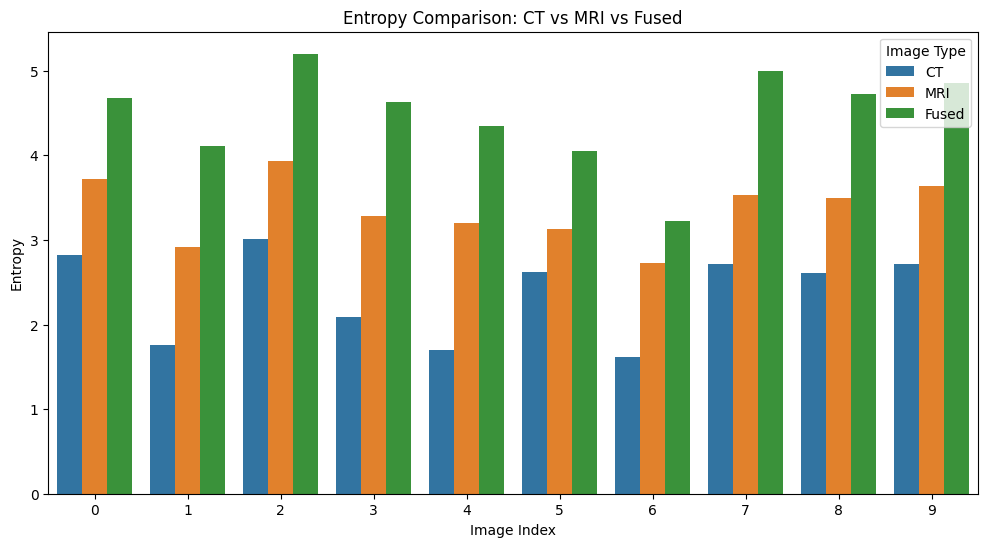

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

entropy_df = pd.DataFrame({
    "Image": image_labels * 3,
    "Entropy": entropy_ct_list + entropy_mri_list + entropy_fused_list,
    "Modality": (["CT"] * len(image_labels)) +
                (["MRI"] * len(image_labels)) +
                (["Fused"] * len(image_labels))
})

plt.figure(figsize=(12, 6))
sns.barplot(
    data=entropy_df,
    x="Image",
    y="Entropy",
    hue="Modality"
)

plt.xlabel("Image Index")
plt.ylabel("Entropy")
plt.title("Entropy Comparison: CT vs MRI vs Fused")
plt.legend(title="Image Type")
plt.show()


In [ ]:
# Lists for PSNR
psnr_ct_list = []
psnr_mri_list = []
psnr_fused_list = []

image_labels = []   # keep same pattern (1–10)


In [ ]:
cnn.eval()
transformer.eval()

with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:
            break

        ct = ct.to(device)
        mri = mri.to(device)

        # Feature extraction
        f_ct = cnn(ct)
        f_mri = transformer(mri)

        # Fusion
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        # Convert to numpy
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Store PSNR values
        psnr_ct_list.append(psnr(ct_np, ct_np))        # CT vs CT (reference)
        psnr_mri_list.append(psnr(ct_np, mri_np))      # CT vs MRI
        psnr_fused_list.append(psnr(ct_np, fused))     # CT vs Fused

        image_labels.append(i + 1)


/tmp/ipython-input-2115549346.py:19: RuntimeWarning: divide by zero encountered in scalar divide
  return 20 * np.log10(1.0 / np.sqrt(mse))


In [ ]:
def psnr(img1, img2):
    mse = np.mean((img1 - img2) ** 2)
    if mse == 0:
        return 100
    return 20 * np.log10(1.0 / np.sqrt(mse))


In [ ]:
psnr_ct_list = []
psnr_mri_list = []
image_labels = []

cnn.eval()
transformer.eval()

with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:
            break

        ct = ct.to(device)
        mri = mri.to(device)

        f_ct = cnn(ct)
        f_mri = transformer(mri)
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        psnr_ct_list.append(psnr(ct_np, fused))
        psnr_mri_list.append(psnr(mri_np, fused))

        image_labels.append(i + 1)   # starts from 1


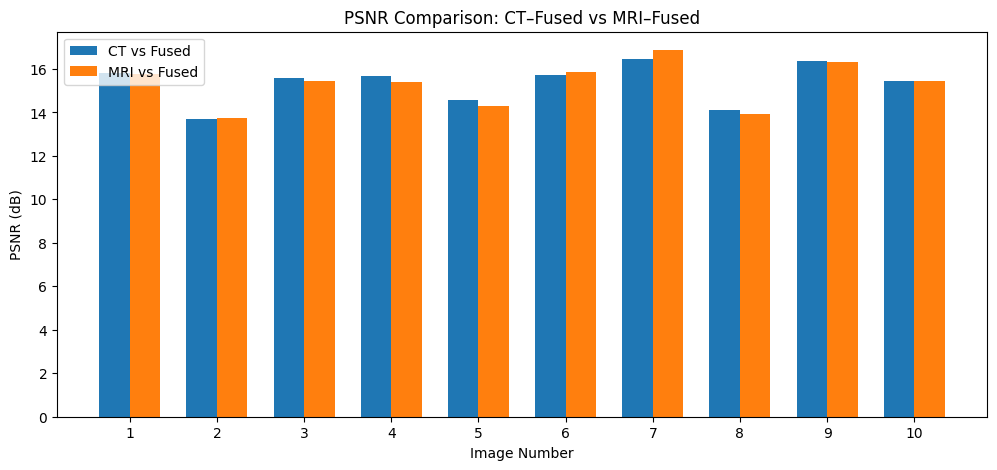

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

x = np.arange(len(image_labels))
width = 0.35

plt.figure(figsize=(12,5))
plt.bar(x - width/2, psnr_ct_list, width, label="CT vs Fused")
plt.bar(x + width/2, psnr_mri_list, width, label="MRI vs Fused")

plt.xticks(x, image_labels)
plt.xlabel("Image Number")
plt.ylabel("PSNR (dB)")
plt.title("PSNR Comparison: CT–Fused vs MRI–Fused")
plt.legend()
plt.show()


/tmp/ipython-input-1744461881.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=image_labels, y=ssim_list, palette="coolwarm")


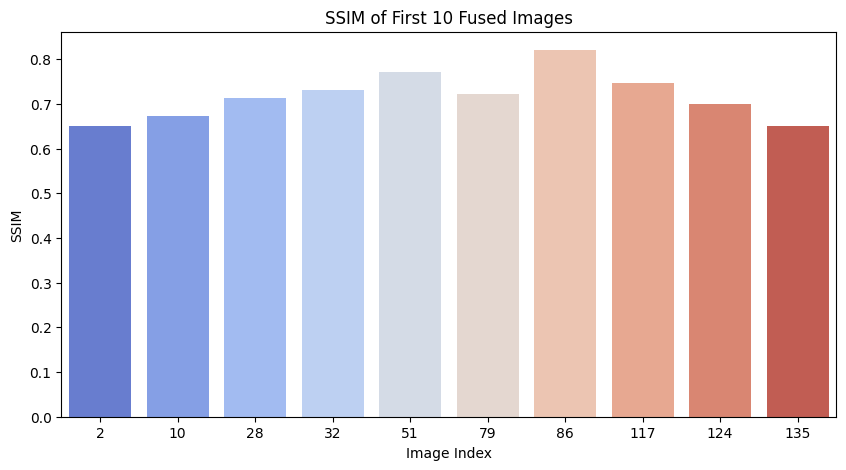

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(x=image_labels, y=ssim_list, palette="coolwarm")
plt.xlabel("Image Index")
plt.ylabel("SSIM")
plt.title("SSIM of First 10 Fused Images")
plt.show()


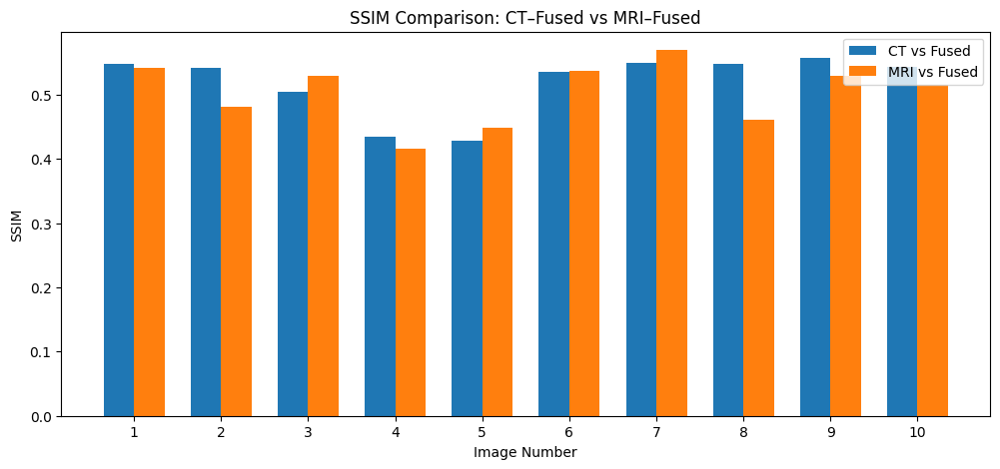

In [ ]:
ssim_ct_list = []
ssim_mri_list = []
from skimage.metrics import structural_similarity as ssim

cnn.eval()
transformer.eval()

with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:
            break

        ct = ct.to(device)
        mri = mri.to(device)

        # Features
        f_ct = cnn(ct)
        f_mri = transformer(mri)

        # Fused output
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # SSIM (CT vs Fused, MRI vs Fused)
        ssim_ct_list.append(ssim(ct_np, fused, data_range=fused.max()-fused.min()))
        ssim_mri_list.append(ssim(mri_np, fused, data_range=fused.max()-fused.min()))
import matplotlib.pyplot as plt
import numpy as np

x = np.arange(len(image_labels))
width = 0.35

plt.figure(figsize=(12,5))
plt.bar(x - width/2, ssim_ct_list, width, label="CT vs Fused")
plt.bar(x + width/2, ssim_mri_list, width, label="MRI vs Fused")

plt.xticks(x, image_labels)
plt.xlabel("Image Number")
plt.ylabel("SSIM")
plt.title("SSIM Comparison: CT–Fused vs MRI–Fused")
plt.legend()
plt.show()


In [ ]:
# Lists to store MI
mi_ct_fused_list = []
mi_mri_fused_list = []

image_labels = []  # 1,2,3,...10

cnn.eval()
transformer.eval()

with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:
            break

        ct = ct.to(device)
        mri = mri.to(device)

        # Features
        f_ct = cnn(ct)
        f_mri = transformer(mri)

        # Fused output
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        # Convert to numpy
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Calculate Mutual Information
        mi_ct_fused_list.append(mutual_information(ct_np, fused))
        mi_mri_fused_list.append(mutual_information(mri_np, fused))

        image_labels.append(i+1)  # start from 1


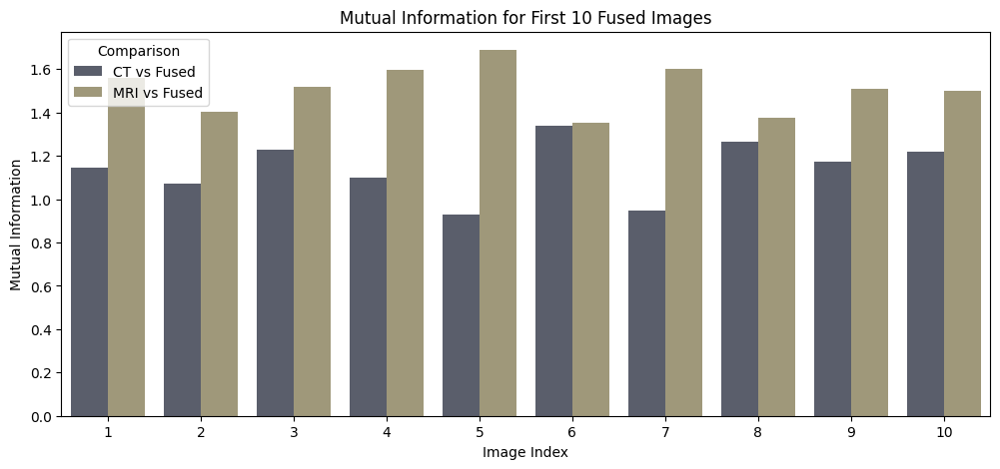

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

mi_df = pd.DataFrame({
    "Image": image_labels * 2,
    "Mutual Info": mi_ct_fused_list + mi_mri_fused_list,
    "Comparison": (["CT vs Fused"] * len(image_labels)) + (["MRI vs Fused"] * len(image_labels))
})

plt.figure(figsize=(12,5))
sns.barplot(data=mi_df, x="Image", y="Mutual Info", hue="Comparison", palette="cividis")
plt.xlabel("Image Index")
plt.ylabel("Mutual Information")
plt.title("Mutual Information for First 10 Fused Images")
plt.show()


/tmp/ipython-input-848171091.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=image_labels, y=mi_list, palette="cividis")


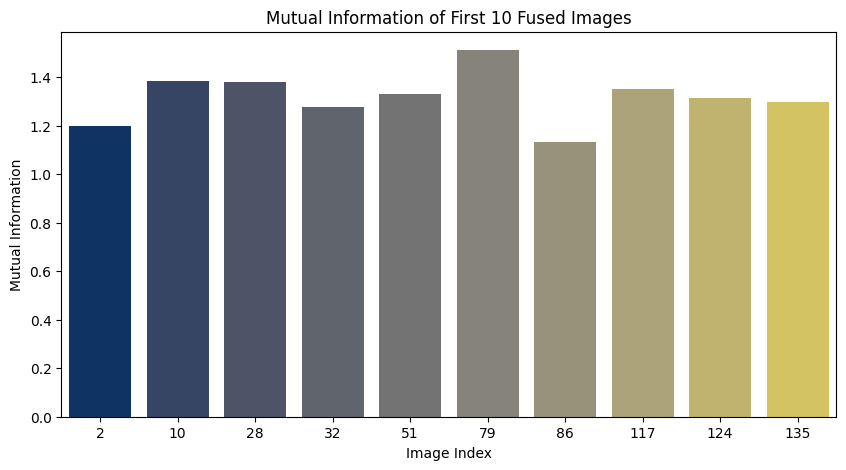

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(x=image_labels, y=mi_list, palette="cividis")
plt.xlabel("Image Index")
plt.ylabel("Mutual Information")
plt.title("Mutual Information of First 10 Fused Images")
plt.show()


/tmp/ipython-input-4165219578.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=image_labels, y=rmse_list, palette="plasma")


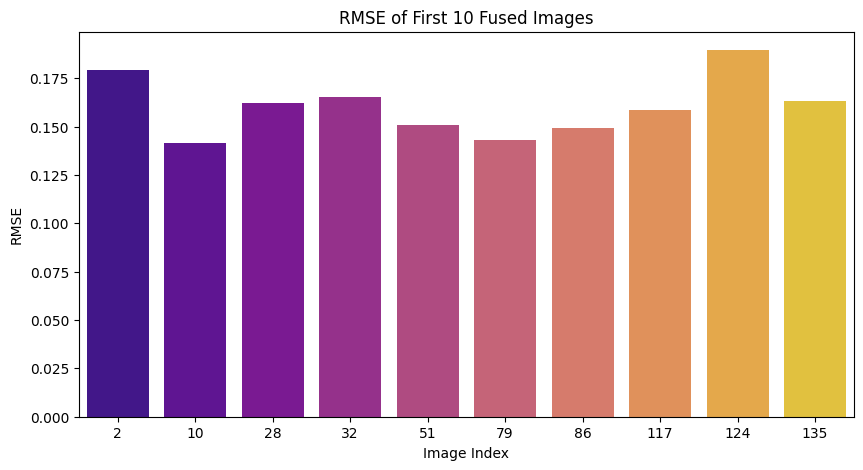

In [ ]:
plt.figure(figsize=(10,5))
sns.barplot(x=image_labels, y=rmse_list, palette="plasma")
plt.xlabel("Image Index")
plt.ylabel("RMSE")
plt.title("RMSE of First 10 Fused Images")
plt.show()


In [ ]:
# Lists for RMSE
rmse_ct_fused_list = []
rmse_mri_fused_list = []

image_labels = []  # 1,2,...10

cnn.eval()
transformer.eval()

with torch.no_grad():
    for i, (ct, mri) in enumerate(test_loader):
        if i >= 10:
            break

        ct = ct.to(device)
        mri = mri.to(device)

        # Features
        f_ct = cnn(ct)
        f_mri = transformer(mri)

        # Fused output
        fused = cross_attention_fusion(f_ct, f_mri).mean(dim=1).squeeze().cpu().numpy()

        # Convert to numpy
        ct_np = ct.squeeze().cpu().numpy()
        mri_np = mri.squeeze().cpu().numpy()

        # Calculate RMSE
        rmse_ct_fused_list.append(rmse(ct_np, fused))
        rmse_mri_fused_list.append(rmse(mri_np, fused))

        image_labels.append(i+1)  # start from 1


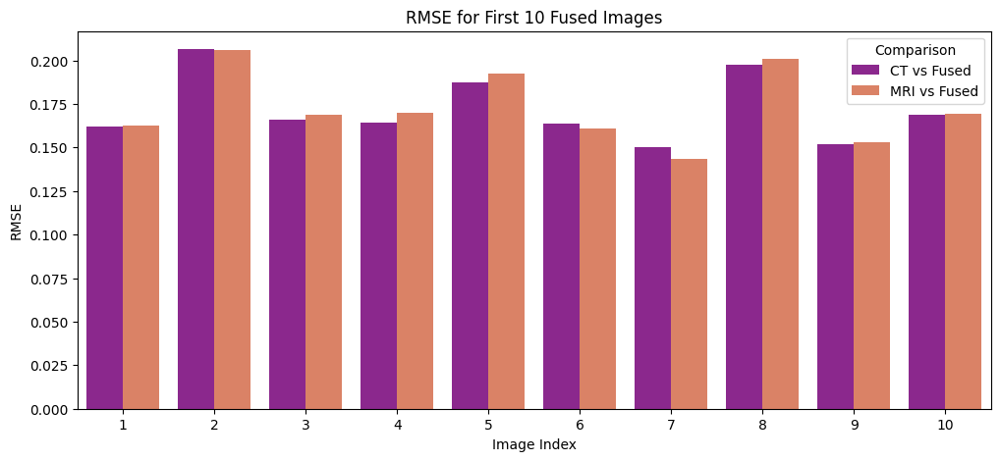

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

rmse_df = pd.DataFrame({
    "Image": image_labels * 2,
    "RMSE": rmse_ct_fused_list + rmse_mri_fused_list,
    "Comparison": (["CT vs Fused"] * len(image_labels)) + (["MRI vs Fused"] * len(image_labels))
})

plt.figure(figsize=(12,5))
sns.barplot(data=rmse_df, x="Image", y="RMSE", hue="Comparison", palette="plasma")
plt.xlabel("Image Index")
plt.ylabel("RMSE")
plt.title("RMSE for First 10 Fused Images")
plt.show()
